# Data mining of semiconductor materials

This notebook is a second approach similar to the two first approaches, however, here we will exclusively look at candidates that we already have knowledge about.

Thereafter, we will use the datamining process to find fitting and unfitting candidates. The process can be described by following some given criteria for good candidates, resulting in the label $1$. Then, we will use the complete opposite criteria to find unfitted candidates, resulting in the label $0$. 

In [2]:
# Optional: Load the "autoreload" extension so that code can change
%load_ext autoreload

#OPTIONAL: Always reload modules so that as you change code in src, it gets loaded
%autoreload 2

In [3]:
from pathlib import Path
data_dir = Path.cwd().parent.parent / "data" 
print("Current data directory {}".format(data_dir))

Current data directory /home/oliver/Dokumenter/masterprosjekt/predicting-solid-state-qubit-candidates/data


In [4]:
# Tools for query of data
from pymatgen import MPRester

# Finding correct use of polar groups
from pymatgen.symmetry.groups import SYMM_DATA, sg_symbol_from_int_number

from src.data.utils import sortByMPID, filterIDs
from src.visualization import visualize

# pandas
import pandas as pd
import numpy as np

from tqdm import tqdm
import random
# Ignore warnings from nan-values in  
np.warnings.filterwarnings('ignore')

In [5]:
title = "Insightful approach"
InsertApproach = "03-insightful-approach"

In [6]:
generatedData = pd.read_pickle(data_dir / "interim" / "featurized" / "featurized-19-03-2021.pkl")

In [7]:
## Inspect the columns
#for i, j in enumerate(generatedData.iloc[114]):
#    print(generatedData.columns[i],j)

In [8]:
StructuralFeatures = [\
    #"GlobalSymmetryFeatures|spacegroup_num",
    "MP|nelements",
    "MP|Polar SG",
    "MP|oxide_type",
    "GlobalSymmetryFeatures|is_centrosymmetric",
    "candidate"]

BondAngleFeatures = [\
    "AverageBondAngle|mean Average bond angle",
    "AverageBondLength|mean Average bond length",
    "candidate"]

ElectronegativityFeatures = [\
    "LocalPropertyDifference|mean local difference in Electronegativity",
    "IonProperty|max ionic char",
    "IonProperty|avg ionic char",
    "candidate"]

BandHOMOAndOrbitalFeatures = [
    "BandCenter|band center",
    "AtomicOrbitals|HOMO_character",
    "AtomicOrbitals|HOMO_element",
    "AtomicOrbitals|HOMO_energy",
    "AtomicOrbitals|gap_AO",
    "candidate"
]

BandLUMOAndOrbitalFeatures = [\
    "BandCenter|band center",
    "AtomicOrbitals|LUMO_character",
    "AtomicOrbitals|LUMO_element",
    "AtomicOrbitals|LUMO_energy",
    "candidate"
]
    
CovalentRadius = [\
    "ElementProperty|MagpieData minimum CovalentRadius",
    "ElementProperty|MagpieData maximum CovalentRadius",
    "ElementProperty|MagpieData range CovalentRadius",
    "ElementProperty|MagpieData mode CovalentRadius",
    "candidate"
]
    
ValenceOrbitalFeatures1 = [\
    "ValenceOrbital|avg s valence electrons",
    "ValenceOrbital|avg p valence electrons",
    "ValenceOrbital|avg d valence electrons",
    "candidate"]
    #"ValenceOrbital|avg f valence electrons"]
    
atomicWeights = {"ElementProperty|MagpieData minimum AtomicWeight": "min weight",
"ElementProperty|MagpieData maximum AtomicWeight": "max weight",
"ElementProperty|MagpieData range AtomicWeight": "range weight",
"ElementProperty|MagpieData mean AtomicWeight": "mean weight",
"ElementProperty|MagpieData avg_dev AtomicWeight": "avg dev weight",
"ElementProperty|MagpieData mode AtomicWeight": "mode weight",
                "spillage":"spillage"}

# Known labelled candidates

## Matches formula

In [9]:
known_good_candidates = ["SiC","SiGe", "C", "Si",
                         "BN", "MoS2", "WSe2", "WS2", #2D
                         "GaN", "GaAs", "AlN", "ZnS", "ZnSe", "ZnO",
                         "AlP", "GaP", "AlAs", "ZnTe", "CdS"
                        ]

known_bad_candidates   = ["NaCl", "FeO2", "FeO4"]


KnownCandidates = generatedData[generatedData.pretty_formula.isin(known_good_candidates)]

Candidates = np.zeros(generatedData.shape[0])-1
Candidates[generatedData[generatedData.pretty_formula.isin(known_good_candidates)].index] = 1
Candidates[generatedData[generatedData.pretty_formula.isin(known_bad_candidates)]  .index] = 0

onlyCandidates = known_good_candidates + known_bad_candidates
print(len(Candidates[Candidates==1]))

202


## Bandgap restriction

In [10]:
# enforcing 0.5eV bandgap restriction
columns = ["material_id", "full_formula", "pretty_formula","MP|Polar SG", "AFLOWML|ml_egap", "MP_Eg", "MP|spacegroup.number", "candidate", "GlobalSymmetryFeatures|crystal_system_int"]
CandidatesWithLowBandgap = generatedData[(Candidates == 1) & (generatedData["MP_Eg"]< 0.5)].index
Candidates[CandidatesWithLowBandgap] = 0
generatedData["candidate"] = Candidates
generatedData.iloc[CandidatesWithLowBandgap][columns]

,material_id,full_formula,pretty_formula,MP|Polar SG,AFLOWML|ml_egap,MP_Eg,MP|spacegroup.number,candidate,GlobalSymmetryFeatures|crystal_system_int
58,mp-370,Cd1S1,CdS,0,0.000,0.3683,225,0.0,1
394,mp-2534,Ga1As1,GaAs,0,0.338,0.1839,216,0.0,1
2287,mp-8883,Ga2As2,GaAs,1,0.383,0.1925,186,0.0,2
2421,mp-9281,Zn3Te3,ZnTe,0,1.045,0.2878,181,0.0,2
3150,mp-13161,Zn1O1,ZnO,0,0.000,0.4345,221,0.0,1
14216,mp-568410,C8,C,0,0.000,0.1231,65,0.0,5
19098,mp-999200,Si4,Si,0,0.309,0.4517,139,0.0,4
19211,mp-1017539,Zn2O2,ZnO,1,1.860,0.4516,186,0.0,2
19629,mp-1071319,Zn3Te3,ZnTe,0,1.046,0.2938,152,0.0,3
19641,mp-1072544,Si6,Si,0,0.526,0.1909,229,0.0,1


## Manual screening
We manually cross-identify a mpid with the structure in materialsproject for verification. 

In [11]:
label_as_bad_candidates = ["mp-169", "mp-569416"] # Graphite-like structure
move_to_test_set = ["C20", "C28", "C48", "C60", "C140", "C240"]

Candidates[generatedData["material_id"].isin(label_as_bad_candidates)] = 0
Candidates[generatedData["full_formula"].isin(move_to_test_set)] = -1

generatedData["candidate"] = Candidates

generatedData[generatedData["pretty_formula"] == "C"][columns]

,material_id,full_formula,pretty_formula,MP|Polar SG,AFLOWML|ml_egap,MP_Eg,MP|spacegroup.number,candidate,GlobalSymmetryFeatures|crystal_system_int
4,mp-24,C8,C,0,3.355,2.7785,206,1.0,1
6,mp-47,C4,C,0,3.166,3.3395,194,1.0,2
7,mp-66,C2,C,0,3.593,4.3387,227,1.0,1
20,mp-169,C2,C,0,1.268,1.7730,166,0.0,3
14216,mp-568410,C8,C,0,0.000,0.1231,65,0.0,5
14389,mp-569304,C4,C,0,0.000,2.6904,166,1.0,3
14404,mp-569416,C8,C,0,2.561,1.5470,166,0.0,3
14430,mp-569567,C14,C,0,4.514,4.4083,166,1.0,3
14515,mp-570002,C8,C,0,3.058,3.2084,229,1.0,1
15455,mp-611426,C8,C,0,4.474,4.5245,194,1.0,2


In [12]:
Candidates[generatedData["full_formula"] == "Si2C2"] = 0
generatedData["candidate"] = Candidates
generatedData[generatedData["pretty_formula"] == "SiC"][columns]

,material_id,full_formula,pretty_formula,MP|Polar SG,AFLOWML|ml_egap,MP_Eg,MP|spacegroup.number,candidate,GlobalSymmetryFeatures|crystal_system_int
1752,mp-7140,Si2C2,SiC,1,2.310,2.3029,186,0.0,2
1892,mp-7631,Si6C6,SiC,1,2.128,2.1121,186,1.0,2
2032,mp-8062,Si1C1,SiC,0,1.555,1.5936,216,1.0,1
2645,mp-9947,Si7C7,SiC,1,2.112,2.1419,160,1.0,3
2924,mp-11713,Si5C5,SiC,1,2.077,1.9728,160,1.0,3
2925,mp-11714,Si4C4,SiC,1,2.210,2.3298,186,1.0,2
14052,mp-567505,Si8C8,SiC,1,2.125,1.8874,186,1.0,2
14061,mp-567551,Si16C16,SiC,1,2.096,2.0641,186,1.0,2
14262,mp-568619,Si5C5,SiC,1,2.066,1.8735,156,1.0,3
14267,mp-568656,Si10C10,SiC,1,2.134,2.0411,156,1.0,3


In [13]:
move_to_test_set_bn = ["mp-344", "mp-1599", "mp-1639", "mp-2653", "mp-13151", "mp-644751", "mp-1077506"]

Candidates[generatedData["material_id"].isin(move_to_test_set_bn)] = -1

generatedData["candidate"] = Candidates

generatedData[generatedData["pretty_formula"] == "BN"][columns]

,material_id,full_formula,pretty_formula,MP|Polar SG,AFLOWML|ml_egap,MP_Eg,MP|spacegroup.number,candidate,GlobalSymmetryFeatures|crystal_system_int
52,mp-344,B4N4,BN,1,4.902,3.5021,9,-1.0,6
157,mp-984,B2N2,BN,0,4.494,4.4938,194,1.0,2
257,mp-1599,B4N4,BN,1,4.511,1.6009,8,-1.0,6
260,mp-1639,B1N1,BN,0,4.531,4.6482,216,-1.0,1
414,mp-2653,B2N2,BN,1,5.098,5.3630,186,-1.0,2
2012,mp-7991,B2N2,BN,0,4.454,4.2704,194,1.0,2
3149,mp-13151,B4N4,BN,0,5.356,4.8257,136,-1.0,4
14449,mp-569655,B4N4,BN,0,4.413,3.8244,14,1.0,6
15341,mp-604884,B2N2,BN,0,4.474,4.4220,187,1.0,2
15708,mp-629015,B2N2,BN,0,4.513,4.0021,194,1.0,2


In [14]:
generatedData[generatedData["pretty_formula"] == "MoSe2"][columns]

,material_id,full_formula,pretty_formula,MP|Polar SG,AFLOWML|ml_egap,MP_Eg,MP|spacegroup.number,candidate,GlobalSymmetryFeatures|crystal_system_int
259,mp-1634,Mo2Se4,MoSe2,0,1.039,1.4176,194,-1.0,2
19268,mp-1018807,Mo2Se4,MoSe2,0,1.096,1.3036,194,-1.0,2


In [15]:
generatedData[generatedData["pretty_formula"] == "WSe2"][columns]

,material_id,full_formula,pretty_formula,MP|Polar SG,AFLOWML|ml_egap,MP_Eg,MP|spacegroup.number,candidate,GlobalSymmetryFeatures|crystal_system_int
288,mp-1821,W2Se4,WSe2,0,1.174,1.5109,194,1.0,2


In [16]:
generatedData[generatedData["pretty_formula"] == "WS2"][columns]

,material_id,full_formula,pretty_formula,MP|Polar SG,AFLOWML|ml_egap,MP_Eg,MP|spacegroup.number,candidate,GlobalSymmetryFeatures|crystal_system_int
28,mp-224,W2S4,WS2,0,1.265,1.5657,194,1.0,2
2605,mp-9813,W1S2,WS2,1,1.305,1.6176,160,1.0,3


In [17]:
generatedData[generatedData["pretty_formula"].isin(["AlP", "GaP", "AlAs", "ZnTe", "CdS"])][columns]

,material_id,full_formula,pretty_formula,MP|Polar SG,AFLOWML|ml_egap,MP_Eg,MP|spacegroup.number,candidate,GlobalSymmetryFeatures|crystal_system_int
58,mp-370,Cd1S1,CdS,0,0.000,0.3683,225,0.0,1
106,mp-672,Cd2S2,CdS,1,1.070,1.1162,186,1.0,2
243,mp-1550,Al1P1,AlP,0,1.793,1.8232,216,1.0,1
343,mp-2172,Al1As1,AlAs,0,1.463,1.6871,216,1.0,1
345,mp-2176,Zn1Te1,ZnTe,0,1.315,1.0782,216,1.0,1
382,mp-2469,Cd1S1,CdS,0,1.025,1.0453,216,1.0,1
387,mp-2490,Ga1P1,GaP,0,1.479,1.6843,216,1.0,1
2284,mp-8880,Al2P2,AlP,1,1.961,2.0228,186,1.0,2
2285,mp-8881,Al2As2,AlAs,1,1.582,1.6862,186,1.0,2
2286,mp-8882,Ga2P2,GaP,1,1.394,1.2984,186,1.0,2


In [18]:
generatedData[generatedData["pretty_formula"].isin(["ZnO"])][columns]

,material_id,full_formula,pretty_formula,MP|Polar SG,AFLOWML|ml_egap,MP_Eg,MP|spacegroup.number,candidate,GlobalSymmetryFeatures|crystal_system_int
314,mp-1986,Zn1O1,ZnO,0,1.767,0.6311,216,1.0,1
335,mp-2133,Zn2O2,ZnO,1,1.888,0.7316,186,1.0,2
348,mp-2229,Zn1O1,ZnO,0,0.000,1.0501,225,1.0,1
3150,mp-13161,Zn1O1,ZnO,0,0.000,0.4345,221,0.0,1
19211,mp-1017539,Zn2O2,ZnO,1,1.860,0.4516,186,0.0,2


In [17]:
pd.DataFrame(generatedData[generatedData.pretty_formula.isin(known_good_candidates)][["material_id", "full_formula", "pretty_formula" , "MP_Eg", "candidate"]])

,material_id,full_formula,pretty_formula,MP_Eg,candidate
4,mp-24,C8,C,2.7785,1.0
6,mp-47,C4,C,3.3395,1.0
7,mp-66,C2,C,4.3387,1.0
15,mp-149,Si2,Si,0.8527,1.0
19,mp-165,Si4,Si,0.5139,1.0
...,...,...,...,...,...
24712,mp-1203790,Si68,Si,1.3630,1.0
24774,mp-1204046,Si106,Si,0.1508,0.0
24848,mp-1204356,Si19C19,SiC,1.8603,1.0
24918,mp-1204627,Si46,Si,1.3020,1.0


## Adding bad candidates from approach 1

In [18]:
trainingSetApproach1    = pd.read_pickle(data_dir / "01-naive-approach" / "processed" / "trainingData.pkl")
trainingTargetApproach1 = pd.read_pickle(data_dir / "01-naive-approach" / "processed" / "trainingTarget.pkl")
badCandidatesFromApproach1 = trainingSetApproach1[trainingTargetApproach1 == 0].sample(400,random_state=1).material_id

In [19]:
badCandidatesFromApproach1

1051     mp-651075
1468    mp-1198817
927      mp-560960
725      mp-555321
871      mp-559311
           ...    
1436    mp-1196695
1395    mp-1193545
1393    mp-1193189
1149     mp-863298
785      mp-556885
Name: material_id, Length: 400, dtype: object

In [20]:
Candidates[generatedData["material_id"].isin(badCandidatesFromApproach1)] = 0
generatedData["candidate"] = Candidates

## Summarizing

In [21]:
print("Number of entries in known candidates:", len(generatedData[generatedData.pretty_formula.isin(known_good_candidates)]))
print("Number of entries in known bad candidates:", len(generatedData[generatedData.pretty_formula.isin(known_bad_candidates)]))
print("Number of good (1) candidates: ", generatedData[generatedData["candidate"]==1].shape[0])
print("Number of bad (0) candidates: ", generatedData[generatedData["candidate"]==0].shape[0])

Number of entries in known candidates: 202
Number of entries in known bad candidates: 3
Number of good (1) candidates:  172
Number of bad (0) candidates:  418


# Parallel coordinate figures
## Structure

In [22]:
import plotly.express as px
fig = px.parallel_categories(generatedData[generatedData["pretty_formula"].isin(onlyCandidates)], 
                             dimensions=StructuralFeatures,
                             color="candidate",
                             color_continuous_scale=px.colors.diverging.Tealrose)
fig.update_layout(autosize=False, width=700, height=500)

fig.show()

In [23]:
fig = px.parallel_coordinates(generatedData, dimensions=BondAngleFeatures,
                              color="candidate",
                              color_continuous_scale=px.colors.diverging.Tealrose)
fig.show()

## Electronegativity, ionic and covalent properties

In [24]:
fig = px.parallel_coordinates(generatedData, dimensions=ElectronegativityFeatures,
                              color="IonProperty|avg ionic char",
                              labels={"LocalPropertyDifference|mean local difference in Electronegativity":"Local difference electroneg",
                                      "IonProperty|max ionic char":"Max ionic char",
                                      "IonProperty|avg ionic char":"Avg ionic char"},
                              color_continuous_scale=px.colors.diverging.Tealrose)
fig.show()

In [25]:
fig = px.parallel_coordinates(generatedData, dimensions=CovalentRadius,
                              labels={'ElementProperty|MagpieData minimum CovalentRadius':'Min covalent radius',
                                      'ElementProperty|MagpieData maximum CovalentRadius':'Max covalent radius',
                                      "ElementProperty|MagpieData range CovalentRadius":'Range covalent radius',
                                      "ElementProperty|MagpieData mode CovalentRadius":"Mode covalent radius"},
                              color="ElementProperty|MagpieData range CovalentRadius",
                              color_continuous_scale=px.colors.diverging.Tealrose)
fig.show()

In [26]:
"""
fig = px.parallel_coordinates(generatedData, dimensions=BandHOMOAndOrbitalFeatures,
                              color="candidate",
                              color_continuous_scale=px.colors.diverging.Tealrose)
fig.show()
"""

'\nfig = px.parallel_coordinates(generatedData, dimensions=BandHOMOAndOrbitalFeatures,\n                              color="candidate",\n                              color_continuous_scale=px.colors.diverging.Tealrose)\nfig.show()\n'

In [27]:
"""
fig = px.parallel_coordinates(generatedData, dimensions=ValenceOrbitalFeatures1,
                              color="candidate",
                              color_continuous_scale=px.colors.diverging.Tealrose)
fig.show()
"""

'\nfig = px.parallel_coordinates(generatedData, dimensions=ValenceOrbitalFeatures1,\n                              color="candidate",\n                              color_continuous_scale=px.colors.diverging.Tealrose)\nfig.show()\n'

# Compare ionic property with covalent property

## 

In [28]:
ElectronegativityFeatures = [\
    "LocalPropertyDifference|mean local difference in Electronegativity",
    "IonProperty|max ionic char",
    "IonProperty|avg ionic char",
    "candidate"]

BondAngleFeatures = [\
    "AverageBondAngle|mean Average bond angle",
    "AverageBondLength|mean Average bond length",
    "candidate"]
CovalentRadius = [\
    "ElementProperty|MagpieData minimum CovalentRadius",
    "ElementProperty|MagpieData maximum CovalentRadius",
    "ElementProperty|MagpieData range CovalentRadius",
    "ElementProperty|MagpieData mode CovalentRadius",
    "candidate"
]

interestingFeatures = {
    "MP|total_magnetization":"Mag",
    "MP|Polar SG": "Polar SG",
    "IonProperty|max ionic char":"Max ionic char",
    #"AverageBondLength|mean Average bond length":"Avg bond length",
    "ElementProperty|MagpieData range CovalentRadius": "Covalent radius range",
    "IonProperty|max ionic char":"Max ionic char",
    "MP|Polar SG": "polar SG",
    #"candidate":"Label",
    #"MP|oxide_type":"Oxid type",
    "MP|nelements": "Number of elements",
    "MP_Eg":"Eg"
}
_oxideType = {"None": 0, "oxide":1, "peroxide":2, "hydroxide":3, "superoxide":4, "ozonide":5}
generatedData["MP|oxide_type"] = generatedData["MP|oxide_type"].map(_oxideType)

In [29]:
fig = px.parallel_coordinates(generatedData, dimensions=interestingFeatures.keys(),
                              labels=interestingFeatures,
                              color=list(interestingFeatures.keys())[4],
                              color_continuous_scale=px.colors.diverging.Tealrose)
fig.show()

In [30]:
import matplotlib.font_manager as font_manager; font_manager._rebuild()

 49%|████▉     | 206/422 [00:00<00:00, 2058.93it/s]

172


100%|██████████| 422/422 [00:00<00:00, 2168.26it/s]


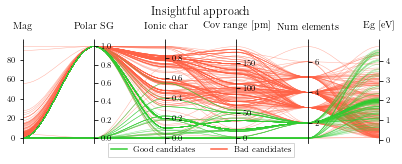

In [31]:
visualize.make_parallel_coordinate_matplot(generatedData, InsertApproach, title=title, applyLegend=True)

In [32]:
fig = px.parallel_coordinates(generatedData, dimensions=interestingFeatures.keys(),
                              labels=interestingFeatures,
                              color=list(interestingFeatures.keys())[5],
                              color_continuous_scale=px.colors.diverging.Tealrose)
fig.show()

In [33]:
fig = px.parallel_coordinates(generatedData, dimensions=atomicWeights,
                              labels=atomicWeights,
                              color=list(atomicWeights.keys())[6],
                              color_continuous_scale=px.colors.diverging.Tealrose)
fig.show()

# Combine data and create training and test set

In [34]:
choose_columns =  ["material_id", "candidate"]
trainingTargets = generatedData[choose_columns][generatedData["candidate"]!=-1]
trainingTargets = sortByMPID(trainingTargets)
trainingTargets = filterIDs(trainingTargets)
trainingTargets

A total of 52 MPIDs are inconsistent with the rest.
A total of 52 MPIDs were dropped from the dataset provided.


,material_id,candidate
0,mvc-12905,0.0
1,mp-24,1.0
2,mp-47,1.0
3,mp-66,1.0
4,mp-149,1.0
...,...,...
585,mp-1275839,0.0
586,mp-1291058,0.0
587,mp-1291630,0.0
588,mp-1298346,0.0


# Distribution of entries in the data
How is the distribution of entries in the different features? 
## Elements

In [35]:
generatedData = pd.read_pickle(data_dir / "interim" / "featurized" / "featurized-19-03-2021.pkl")

In [36]:
testSet = (
    trainingTargets.merge(generatedData, 
              on='material_id', 
              how='outer', 
              indicator=True)
    .query('_merge != "both"')
    .drop(columns='_merge')
)
trainingSet = (
    trainingTargets.merge(generatedData,
                on="material_id",
                indicator=False,
                how="left",
                suffixes=(False, False))
)

In [37]:
print(testSet.shape)
print(trainingSet.shape)

(24614, 4872)
(590, 4872)


In [38]:
print("The amount of good qubit host candidates: {}, or {:0.4f}%".format(trainingSet[trainingTargets.values==1].shape[0], trainingSet[trainingTargets.values==1].shape[0]/trainingSet.shape[0]))
print("The amount of bad qubit host candidates: {}, or {:0.4f}%".format(trainingSet[trainingTargets.values==0].shape[0], trainingSet[trainingTargets.values==0].shape[0]/trainingSet.shape[0]))

The amount of good qubit host candidates: 172, or 0.2915%
The amount of bad qubit host candidates: 418, or 0.7085%


In [39]:
print("Information about elements in compoounds are given in the interval:")
print(np.where(generatedData.columns=="H")[0][0],np.where(generatedData.columns=="Pu")[0][0])
# plotting 
import plotly.graph_objects as go
elements = generatedData.columns[
    np.where(generatedData.columns=="H")[0][0]:np.where(generatedData.columns=="Pu")[0][0]
].values
print(len(elements))
fig = go.Figure( 
    layout = go.Layout (
        title=go.layout.Title(text="Distribution of elements in training data"),
        yaxis=dict(title='Number of times occuring elements'),
        xaxis=dict(title='Elements'),
        xaxis_tickangle=-45
        )
    )

fittedCounts = trainingSet[elements][trainingTargets.values==1].fillna(0).astype(bool).sum(axis=0)
unFittedCounts   = trainingSet[elements][trainingTargets.values==0].fillna(0).astype(bool).sum(axis=0)

fig.add_traces(go.Bar(name = "Fitted candidates",#prettyNames[i], 
                        x = trainingSet[elements].columns,
                        y = fittedCounts,
                        text = trainingSet[elements].columns,
                        )
                )
fig.add_traces(go.Bar(name = "Unfitted candidates",#prettyNames[i], 
                        x = trainingSet[elements].columns,
                        y = unFittedCounts,
                        text = trainingSet[elements].columns,
                        )
                )
fig.show()

Information about elements in compoounds are given in the interval:
4702 4795
93


In [40]:
fig = go.Figure( 
    layout = go.Layout (
        title=go.layout.Title(text="Normal adjusted counts of elements in training data"),
        yaxis=dict(title='Normal adjusted counts'),
        xaxis=dict(title='Elements'),
        xaxis_tickangle=-45
        )
    )

fig.add_traces(
    go.Bar(name = "Fitted candidates",#prettyNames[i], 
                   x =    trainingSet[elements].columns,
                   y =    fittedCounts/np.sum(fittedCounts),
                   text = trainingSet[elements].columns,
                    )
                )
fig.add_traces(go.Bar(name = "Unfitted candidates",#prettyNames[i], 
                    x = trainingSet[elements].columns,
                    y = unFittedCounts/np.sum(unFittedCounts),
                    text = trainingSet[elements].columns,
                    )
                )
fig.show()

## Known candidates 

How are the known candidates already doing in the datamining process? SiC, etc. 

In [41]:
feat = ["material_id","MP_Eg","pretty_formula","full_formula"]

#generatedData[feat][generatedData["pretty_formula"]=="SiC"]

In [42]:
#generatedData[feat][generatedData["pretty_formula"]=="C"]

In [43]:
feat = ["material_id","MP_Eg","pretty_formula","full_formula", "candidate"]

trainingSet[feat][(trainingSet["pretty_formula"]=="SiC")]

,material_id,MP_Eg,pretty_formula,full_formula,candidate
40,mp-7140,2.3029,SiC,Si2C2,0.0
42,mp-7631,2.1121,SiC,Si6C6,1.0
45,mp-8062,1.5936,SiC,Si1C1,1.0
55,mp-9947,2.1419,SiC,Si7C7,1.0
59,mp-11713,1.9728,SiC,Si5C5,1.0
60,mp-11714,2.3298,SiC,Si4C4,1.0
286,mp-567505,1.8874,SiC,Si8C8,1.0
287,mp-567551,2.0641,SiC,Si16C16,1.0
289,mp-568619,1.8735,SiC,Si5C5,1.0
290,mp-568656,2.0411,SiC,Si10C10,1.0


In [44]:
trainingSet[feat][(trainingSet["pretty_formula"]=="C")]

,material_id,MP_Eg,pretty_formula,full_formula,candidate
1,mp-24,2.7785,C,C8,1.0
2,mp-47,3.3395,C,C4,1.0
3,mp-66,4.3387,C,C2,1.0
6,mp-169,1.7730,C,C2,0.0
288,mp-568410,0.1231,C,C8,0.0
295,mp-569304,2.6904,C,C4,1.0
296,mp-569416,1.5470,C,C8,0.0
297,mp-569567,4.4083,C,C14,1.0
300,mp-570002,3.2084,C,C8,1.0
324,mp-611426,4.5245,C,C8,1.0


## Combine training targets with preprocessed data

In [45]:
processedData = pd.read_pickle(data_dir / "processed" / "processedData.pkl")
processedData.shape

(25204, 679)

In [46]:
trainingSet = (
    trainingTargets.merge(processedData,
                on="material_id",
                indicator=False,
                how="left",
                suffixes=(False, False))
)
trainingSet.shape

(590, 680)

In [47]:
# Drop new candidates that might have been added to MP after featurization 
trainingSet = trainingSet[trainingSet["material_id"].isin(processedData["material_id"])]
trainingSet.shape

(590, 680)

In [48]:
testSet = (
    trainingTargets.merge(processedData, 
              on='material_id', 
              how='outer', 
              indicator=True)
    .query('_merge != "both"')
    .drop(columns='_merge')
)
testSet.shape

(24614, 680)

In [49]:
# Drop selected features that are too easy to predict on
dropColumns = ["MP|nelements"]
trainingSet = trainingSet.drop(dropColumns, axis=1)
testSet     = testSet.drop(dropColumns, axis=1)

# Drop new candidates that might have been added to MP after featurization 
testSet = testSet[testSet["material_id"].isin(processedData["material_id"])]
testSet.shape

# Change column order
trainingSet.insert(1, 'full_formula', trainingSet.pop("full_formula"))
testSet    .insert(1, 'full_formula', testSet    .pop("full_formula"))
testSet    .insert(1, 'pretty_formula', testSet    .pop("pretty_formula"))

In [50]:
trainingSet = trainingSet.drop(["pretty_formula"], axis=1)
trainingTarget = trainingSet.pop("candidate")

Path(data_dir / InsertApproach / "processed").mkdir(parents=True, exist_ok=True)
trainingSet   .to_pickle(data_dir / InsertApproach /"processed" / "trainingData.pkl")
trainingTarget.to_pickle(data_dir / InsertApproach / "processed" / "trainingTarget.pkl")
testSet       .to_pickle(data_dir / InsertApproach / "processed" / "testSet.pkl")

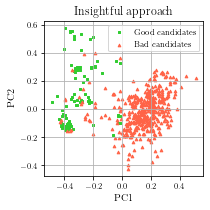

In [51]:
df = trainingSet.copy()
df["candidate"] = trainingTarget
#df = df.groupby('candidate').apply(lambda s: s.sample(min(len(s), 200)))
visualize.plot_2d_pca(df, df["candidate"], InsertApproach, title, legend=True)

95% accumulated variance needs 103 principal components


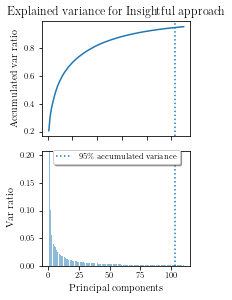

0.207023177581241


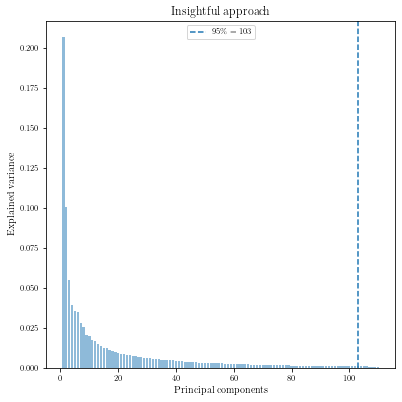

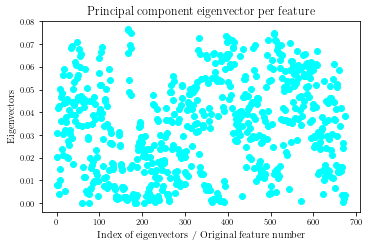

In [53]:
visualize.principalComponentsVSvariance(X = trainingSet.drop(["material_id", "full_formula"], axis=1),
                                     approach = title)